In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns # data visualization library based on matplotlib
import missingno as msn
import matplotlib.pyplot as plt
from folium.plugins import HeatMap
from folium import plugins
from collections import namedtuple
from shapely.geometry import Point
import folium #visualize spatial data in an interactive manner
%matplotlib inline

from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split, KFold, cross_val_score, learning_curve
from sklearn.metrics import confusion_matrix,precision_score, recall_score,f1_score, accuracy_score, balanced_accuracy_score, plot_confusion_matrix, precision_recall_fscore_support 

from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
import statsmodels.api as sm
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.arima_process import arma_generate_sample, ArmaProcess

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

kfold = KFold(n_splits=5)

In [2]:
acp = pd.read_csv("crime.csv")
acp

,Dc_Dist,Psa,Dispatch_Date_Time,Dispatch_Date,Dispatch_Time,Hour,Dc_Key,Location_Block,UCR_General,Text_General_Code,Police_Districts,Month,Lon,Lat
0,18,3,2009-10-02 14:24:00,2009-10-02,14:24:00,14,200918067518,S 38TH ST / MARKETUT ST,800.0,Other Assaults,NaN,2009-10,NaN,NaN
1,14,1,2009-05-10 00:55:00,2009-05-10,00:55:00,0,200914033994,8500 BLOCK MITCH,2600.0,All Other Offenses,NaN,2009-05,NaN,NaN
2,25,J,2009-08-07 15:40:00,2009-08-07,15:40:00,15,200925083199,6TH CAMBRIA,800.0,Other Assaults,NaN,2009-08,NaN,NaN
3,35,D,2009-07-19 01:09:00,2009-07-19,01:09:00,1,200935061008,5500 BLOCK N 5TH ST,1500.0,Weapon Violations,20.0,2009-07,-75.130477,40.036389
4,9,R,2009-06-25 00:14:00,2009-06-25,00:14:00,0,200909030511,1800 BLOCK WYLIE ST,2600.0,All Other Offenses,8.0,2009-06,-75.166350,39.969532
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2237600,1,1,2017-01-17 09:13:00,2017-01-17,09:13:00,9,201701002678,2100 BLOCK S BROAD ST,2600.0,All Other Offenses,1.0,2017-01,-75.169992,39.923556
2237601,16,1,2017-01-17 22:35:00,2017-01-17,22:35:00,22,201716002117,N 38TH ST / WALLACE ST,2600.0,All Other Offenses,12.0,2017-01,-75.197627,39.964593
2237602,16,1,2017-01-17 22:35:00,2017-01-17,22:35:00,22,201716002118,N 38TH ST / WALLACE ST,2600.0,All Other Offenses,12.0,2017-01,-75.197627,39.964593
2237603,19,2,2017-01-18 01:23:00,2017-01-18,01:23:00,1,201719004939,6000 BLOCK HAVERFORD AV,2600.0,All Other Offenses,15.0,2017-01,-75.240163,39.970507


In [3]:
acp.dtypes

Dc_Dist                 int64
Psa                    object
Dispatch_Date_Time     object
Dispatch_Date          object
Dispatch_Time          object
Hour                    int64
Dc_Key                  int64
Location_Block         object
UCR_General           float64
Text_General_Code      object
Police_Districts      float64
Month                  object
Lon                   float64
Lat                   float64
dtype: object

In [4]:
# remove all na values from the dataset
# acpc == All Crime Philidelphia Cleaned
acpc = acp.dropna()

# changing dtype police district to int
acpc = acpc.astype({'Police_Districts': 'int64'})

# order based on date
acpc['Dispatch_Date_Time'] = pd.to_datetime(acpc['Dispatch_Date_Time'])
acpc.set_index('Dispatch_Date_Time', inplace=True)
acpc.sort_index(inplace=True)

# creating a seperate list for each year, month and day 
acpc['month'] = acpc.index.month
acpc['year'] = acpc.index.year
acpc['day'] = acpc.index.day
acpc['crimes'] = 1

# removing the year 2017 since it's not a complete year
acpc = acpc[acpc.index < '2016-10-01']

# showing the first 5 rows
acpc.head()

,Dc_Dist,Psa,Dispatch_Date,Dispatch_Time,Hour,Dc_Key,Location_Block,UCR_General,Text_General_Code,Police_Districts,Month,Lon,Lat,month,year,day,crimes
Dispatch_Date_Time,,,,,,,,,,,,,,,,,
2006-01-01 00:00:00,3,I,2006-01-01,00:00:00,0,200603000002,S 8TH ST /SOUTH ST,2600.0,All Other Offenses,3,2006-01,-75.155491,39.942416,1,2006,1,1
2006-01-01 00:02:00,19,R,2006-01-01,00:02:00,0,200619000047,5500 BLOCK CHERRY ST,800.0,Other Assaults,15,2006-01,-75.231975,39.963220,1,2006,1,1
2006-01-01 00:02:00,3,I,2006-01-01,00:02:00,0,200603000001,S 8TH ST /SOUTH ST,2600.0,All Other Offenses,3,2006-01,-75.155491,39.942416,1,2006,1,1
2006-01-01 00:04:00,18,Q,2006-01-01,00:04:00,0,200618000007,400 BLOCK S 55TH ST,1500.0,Weapon Violations,14,2006-01,-75.232374,39.953490,1,2006,1,1
2006-01-01 00:05:00,12,P,2006-01-01,00:05:00,0,200612000011,1700 BLOCK S 58TH ST,1500.0,Weapon Violations,9,2006-01,-75.230711,39.937644,1,2006,1,1


In [5]:
acpc.Text_General_Code.value_counts()

All Other Offenses                         421744
Other Assaults                             264898
Thefts                                     244501
Vandalism/Criminal Mischief                192406
Theft from Vehicle                         163467
Narcotic / Drug Law Violations             132452
Fraud                                      108231
Burglary Residential                        91643
Recovered Stolen Motor Vehicle              90676
Aggravated Assault No Firearm               66069
DRIVING UNDER THE INFLUENCE                 50920
Robbery No Firearm                          49585
Motor Vehicle Theft                         45069
Disorderly Conduct                          39269
Robbery Firearm                             38651
Aggravated Assault Firearm                  26657
Burglary Non-Residential                    22565
Weapon Violations                           17963
Other Sex Offenses (Not Commercialized)     14778
Prostitution and Commercialized Vice        12355


In [8]:
# Look at some distinct data
dc_dist_distinct = acpc.groupby('Dc_Dist')['Dc_Dist'].count()
print(dc_dist_distinct)
print("\n")

ucr_text_distinct = acpc.groupby(['UCR_General', 'Text_General_Code']).size()
print(ucr_text_distinct)

Dc_Dist
1      46972
2     112211
3      81816
4      28986
5      29960
6      92407
7      42937
8      71154
9      80400
12    127281
14    116409
15    177419
16     69917
17     72460
18    104158
19    131112
22    121438
23     27117
24    155401
25    145462
26     83793
35    126096
39     92466
77      4366
92      1289
Name: Dc_Dist, dtype: int64


UCR_General  Text_General_Code                      
100.0        Homicide - Criminal                          3286
             Homicide - Gross Negligence                    12
             Homicide - Justifiable                         40
200.0        Rape                                        11277
300.0        Robbery Firearm                             38651
             Robbery No Firearm                          49585
400.0        Aggravated Assault Firearm                  26657
             Aggravated Assault No Firearm               66069
500.0        Burglary Non-Residential                    22565
             Burg

In [9]:
## Look at most frequent streets and intersections - where are these located in the city?
location_distinct = acpc.groupby(['Location_Block', 'Dc_Dist']).size()
location_distinct.sort_values(ascending=False, inplace=True)
print(location_distinct[:30])

Location_Block                          Dc_Dist
4600 BLOCK E ROOSEVELT BLVD             2          4077
1000 BLOCK MARKET ST                    6          3909
5200 BLOCK FRANKFORD AVE                15         3467
1300 BLOCK MARKET ST                    6          2611
0 BLOCK N 52ND ST                       19         2254
1500 BLOCK MARKET ST                    9          2198
2300 BLOCK COTTMAN AVE                  2          2002
2700 BLOCK KENSINGTON AVE               24         1991
2800 BLOCK KENSINGTON AVE               24         1967
200 BLOCK S 13TH ST                     6          1647
1600 BLOCK S CHRISTOPHER COLUMBUS BLVD  3          1628
300 BLOCK SOUTH ST                      3          1621
1500 BLOCK JOHN F KENNEDY BLVD          9          1583
400 BLOCK SOUTH ST                      3          1576
5900 BLOCK N BROAD ST                   35         1576
1500 BLOCK N 52ND ST                    19         1549
3400 BLOCK N BROAD ST                   25         1460


**Figure 1: Total number of crimes commited per year**<br>
The first figure shows you the total nubmer of crimes commited per year. From this figure we can conclude that almost every year there is a decrease in the number of crimes happening. 

Text(0.5, 1.0, 'Total number of crimes commited per year')

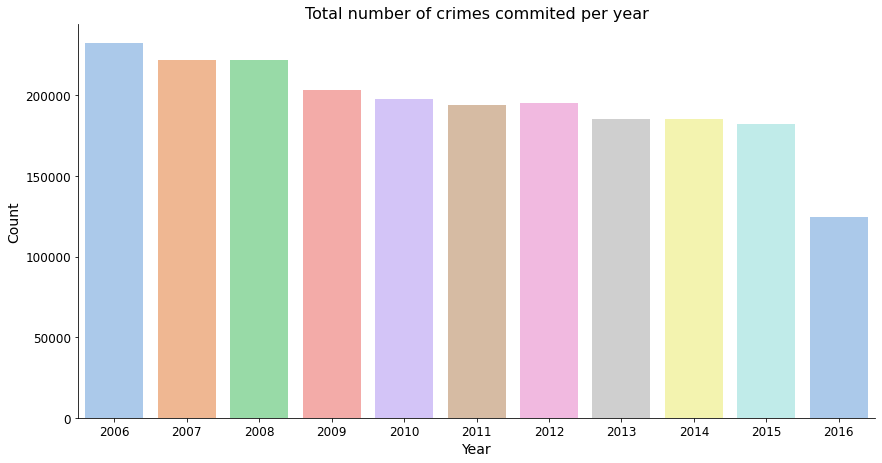

In [16]:
sns.catplot(x='year',
            kind='count',
            palette=("pastel"),
            height=6,
            aspect=2,
            data=acpc)

plt.xticks(size=12)
plt.yticks(size=12)
plt.xlabel("Year", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.title("Total number of crimes commited per year", fontsize=16)

**Figure 2: Number of crimes commited per Month**<br>
Figure 2 shows us the number of crimes happening in each month. Given this figure we can see that a decrease happens towards the end of the year throughout the beginning of the year. This might be due to the outside temperature of these months.

Text(0.5, 1.0, 'Number of Crimes Commited per Month')

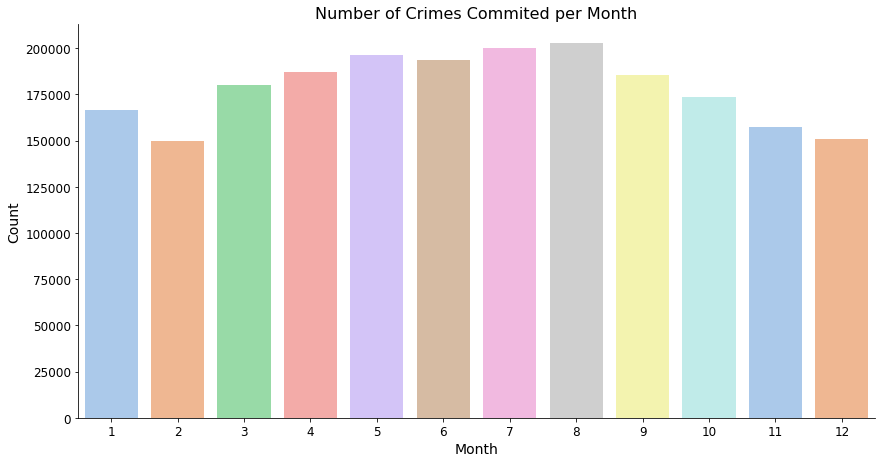

In [17]:
sns.catplot(x='month',
           kind='count',
           height=6,
           aspect=2,
           palette=("pastel"),
           data=acpc)

plt.xticks(size=12)
plt.yticks(size=12)
plt.xlabel("Month", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.title("Number of Crimes Commited per Month", fontsize=16)

**Figure 3: Number of crimes commited per hour**<br>
In the third figure we can see that the number of crimes happening reaches a peak at 16:00h and is at its lowest point around 06:00h. Which is probably due to the sleeping scheduele of people. Furthermore it might be intersting to look at the different types of crime happening around each hour.

Text(0.5, 1.0, 'Number of Crimes Commited per Hour')

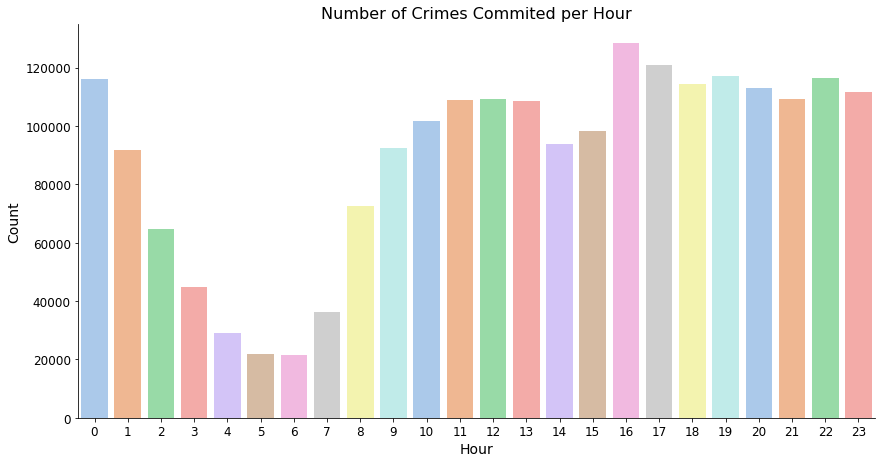

In [18]:
sns.catplot(x='Hour',
           kind='count',
           height=6,
           aspect=2,
           palette=("pastel"),
           data=acpc)
plt.xticks(size=12)
plt.yticks(size=12)
plt.xlabel("Hour", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.title("Number of Crimes Commited per Hour", fontsize=16)

**Figure 4: Number of Times a Specific Crime was Commited**<br>
In figure 4, the number of times each crime is commited is visualized. Where the named category Assualts and Theft are crimes that are commited the most within Philadelphia

Text(0.5, 1.0, 'Number of Times a Specific Crime was Commited')

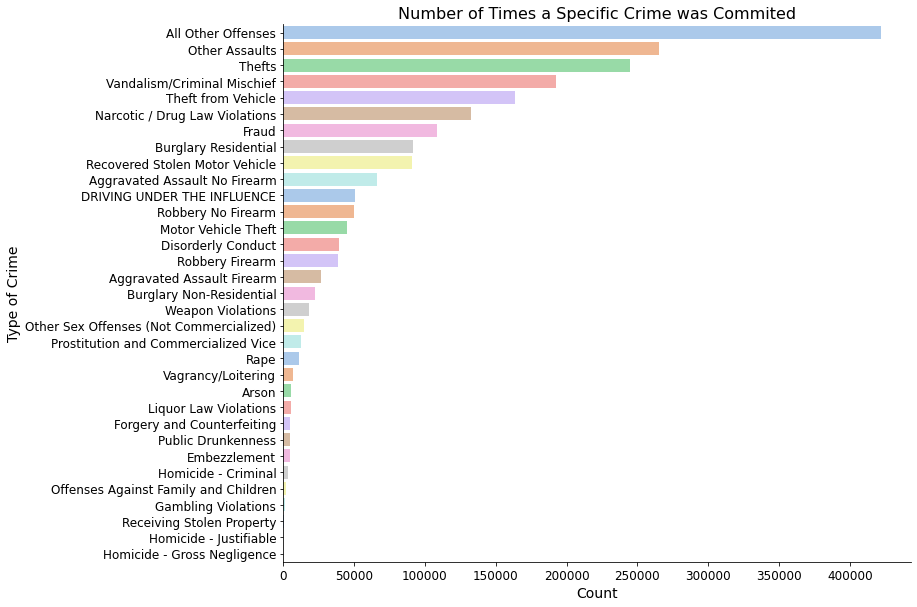

In [19]:
sns.catplot(y='Text_General_Code',
           kind ='count',
           height = 8,
           aspect =1.5, 
           palette=("pastel"),
           order=acpc.Text_General_Code.value_counts().index,
           data=acpc)

plt.xticks(size=12)
plt.yticks(size=12)
plt.xlabel("Count", fontsize=14)
plt.ylabel("Type of Crime", fontsize=14)
plt.title("Number of Times a Specific Crime was Commited", fontsize=16)

**Figure 5: Number of Times a Specific Crime was Commited**<br>
In the last figure, figure 5, the number of times a crime is commited in each district is visualized. From this we can see that most crimes happen district 11

Text(0.5, 1.0, 'Number of Crimes Commited per Police District')

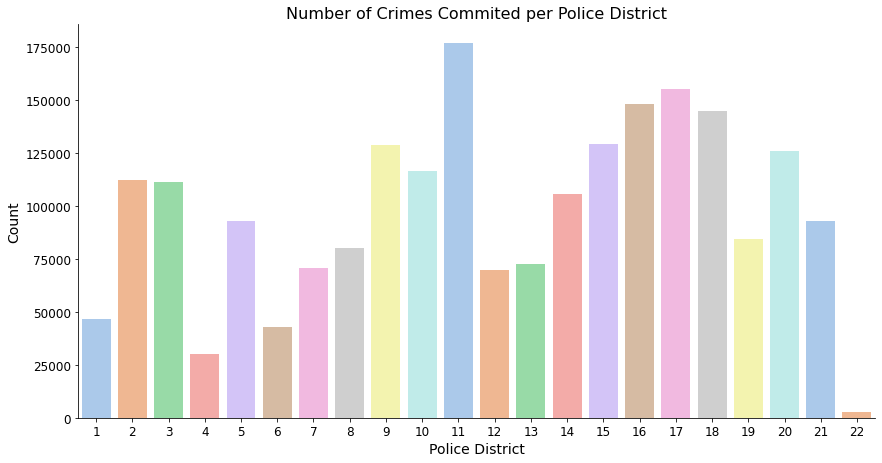

In [20]:
sns.catplot(x='Police_Districts',
           kind='count',
           height=6,
           aspect=2,
           palette=("pastel"),
           data=acpc)
plt.xticks(size=12)
plt.yticks(size=12)
plt.xlabel("Police District", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.title("Number of Crimes Commited per Police District", fontsize=16)

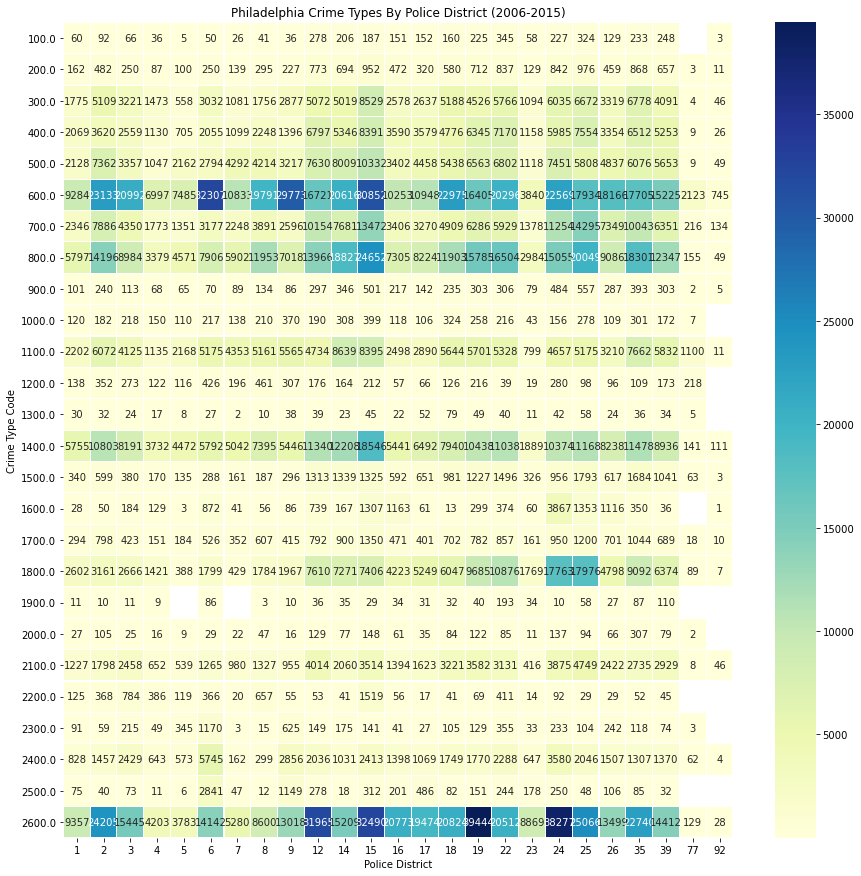

In [24]:
# Crime types by police district
crime_data_type_dist = acpc.groupby(['UCR_General', 'Dc_Dist']).size()
crime_data_type_dist = crime_data_type_dist.apply(int)
crime_data_type_dist_df = crime_data_type_dist.to_frame()
crime_data_type_dist_pt = pd.pivot_table(crime_data_type_dist_df, index=['UCR_General'], columns=['Dc_Dist'])[0] # Get rid of '0 column'

# Heatmap representation
f, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(data=crime_data_type_dist_pt, annot=True, linewidths=0.1, fmt='g', cmap="YlGnBu", ax=ax)
plt.title("Philadelphia Crime Types By Police District (2006-2015)")
plt.xlabel("Police District")
plt.ylabel("Crime Type Code")
plt.show()

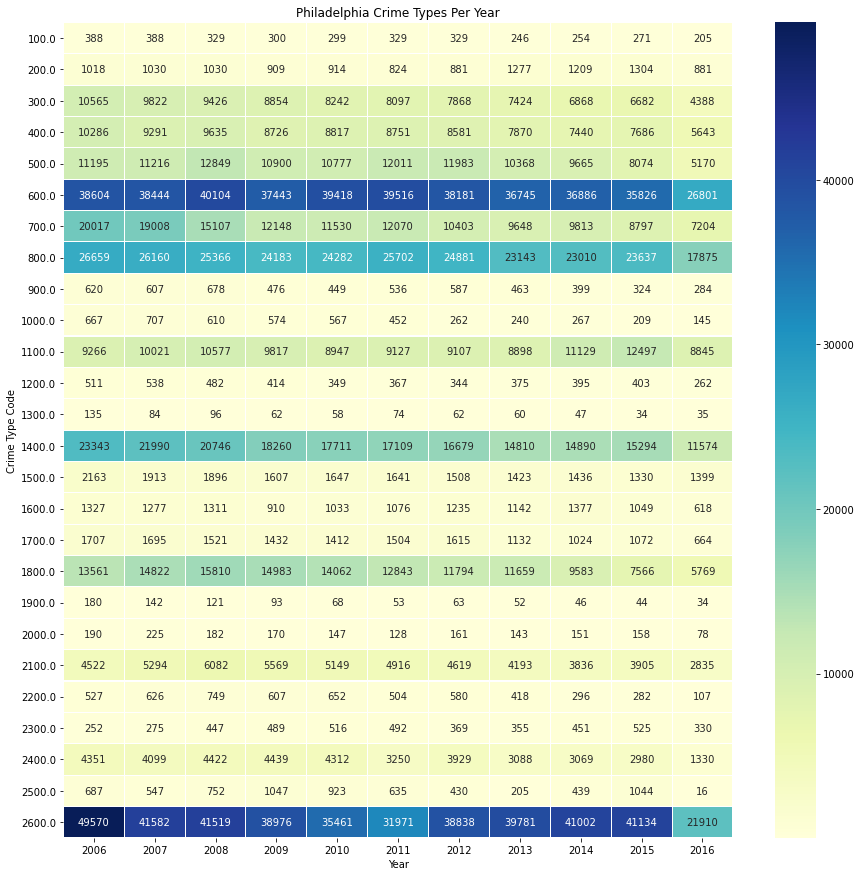

In [15]:
# Crime types by year
crime_data_type_year = acpc.groupby(['UCR_General', 'year']).size()
crime_data_type_year = crime_data_type_year.apply(int)
crime_data_type_year_df = crime_data_type_year.to_frame()
crime_data_type_year_pt = pd.pivot_table(crime_data_type_year_df, index=['UCR_General'], columns=['year'])[0] # Get rid of '0 column'

# Heatmap representation
f, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(data=crime_data_type_year_pt, annot=True, linewidths=0.1, fmt='g', cmap="YlGnBu", ax=ax)
plt.title("Philadelphia Crime Types Per Year")
plt.xlabel("Year")
plt.ylabel("Crime Type Code")
plt.show()

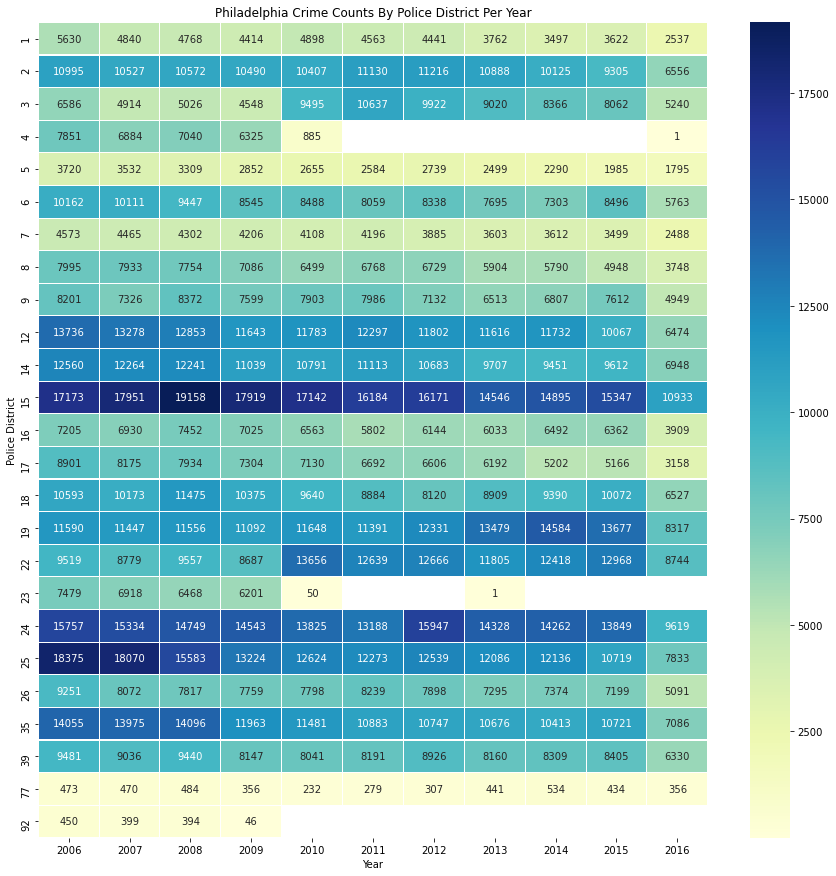

In [17]:
# Police district crime counts by year
crime_data_dist_year = acpc.groupby(['Dc_Dist', 'year']).size()
crime_data_dist_year = crime_data_dist_year.apply(int)
crime_data_dist_year_df = crime_data_dist_year.to_frame()
crime_data_dist_year_pt = pd.pivot_table(crime_data_dist_year_df, index=['Dc_Dist'], columns=['year'])[0] # Get rid of '0 column'

# Heatmap representation
f, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(data=crime_data_dist_year_pt, annot=True, linewidths=0.1, fmt='g', cmap="YlGnBu", ax=ax)
plt.title("Philadelphia Crime Counts By Police District Per Year")
plt.xlabel("Year")
plt.ylabel("Police District")
plt.show()

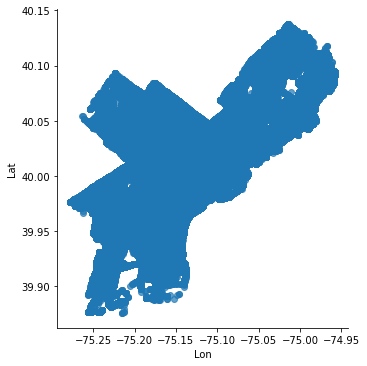

In [21]:
sns.lmplot(x='Lon', y='Lat',# hue='Zone/Beat', 
           data=acpc, 
           fit_reg=False, scatter_kws={'alpha':0.7})

<ipython-input-9-7251525c38c4>:4: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


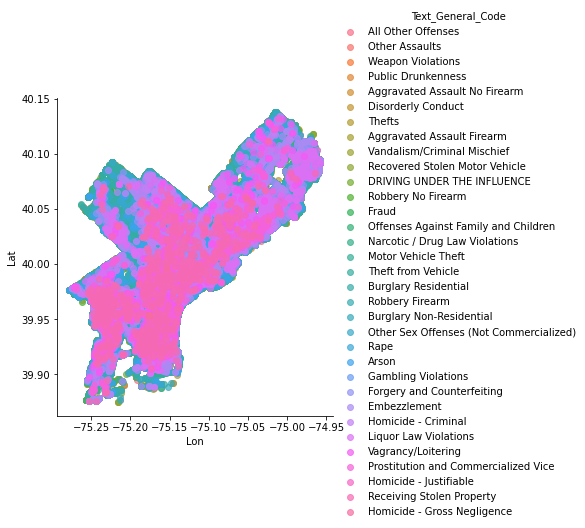

In [9]:
sns.lmplot(x='Lon', y='Lat',  hue='Text_General_Code', 
           data=acpc, 
           fit_reg=False, scatter_kws={'alpha':0.7})
fig.show()

**Given the previous image, an indication is given of where each district is placed in the map below.**

In [37]:
lon = acpc['Lon']
lat = acpc['Lat']
avgLon = sum(lon)/len(lon)
avgLat = sum(lat)/len(lat)

districts_location = acpc[['Police_Districts', 'Lon', 'Lat']]
districts = districts_location.groupby(['Police_Districts']).mean().reset_index()


crime_map = folium.Map(location=[avgLat, avgLon], 
                       tiles = "Stamen Toner",
                      zoom_start = 11)

# Add data for heatmp 
data_heatmap = acpc[-25000:]
data_heatmap = data_heatmap[['Lat','Lon']]
data_heatmap = [[row['Lat'],row['Lon']] for index, row in data_heatmap.iterrows()]
HeatMap(data_heatmap, radius=10).add_to(crime_map)
for i in range(len(districts)):
    folium.Marker([districts['Lat'][i], districts['Lon'][i]], popup='District ' + str(districts['Police_Districts'][i])).add_to(crime_map)

# Plot!
crime_map

**The following heatmaps shows the areas in which most crimes, thef crime and violent crime happen**

In [23]:
lon = acpc['Lon']
lat = acpc['Lat']
avgLon = sum(lon)/len(lon)
avgLat = sum(lat)/len(lat)

crime_map = folium.Map(location=[avgLat, avgLon], 
                       tiles = "Stamen Toner",
                      zoom_start = 11)

# Add data for heatmp 
data_heatmap = acpc[-25000:]
data_heatmap = data_heatmap[['Lat','Lon']]
data_heatmap = [[row['Lat'],row['Lon']] for index, row in data_heatmap.iterrows()]
HeatMap(data_heatmap, radius=10).add_to(crime_map)

# Plot!
crime_map

In [24]:
#showing all types of crimes commited
acpc.Text_General_Code.unique()

# The most dangerous crime (weapon involved) types that can be commited
dangerous = ['Weapon Violations', 'Robbery Firearm', 'Homicide - Criminal', 'Aggravated Assault Firearm', 'Homicide - Gross Negligence', 'Homicide - Justifiable']
# creating a new dataframe with all the dangerous crimes in it
dangerous_data = acpc[acpc['Text_General_Code'].isin(dangerous)]

dangerous_data.head()

,Dc_Dist,Psa,Dispatch_Date,Dispatch_Time,Hour,Dc_Key,Location_Block,UCR_General,Text_General_Code,Police_Districts,Month,Lon,Lat,month,year,day,crimes
Dispatch_Date_Time,,,,,,,,,,,,,,,,,
2006-01-01 00:04:00,18,Q,2006-01-01,00:04:00,0,200618000007,400 BLOCK S 55TH ST,1500.0,Weapon Violations,14,2006-01,-75.232374,39.953490,1,2006,1,1
2006-01-01 00:05:00,12,P,2006-01-01,00:05:00,0,200612000011,1700 BLOCK S 58TH ST,1500.0,Weapon Violations,9,2006-01,-75.230711,39.937644,1,2006,1,1
2006-01-01 00:09:00,35,R,2006-01-01,00:09:00,0,200635000008,6600 BLOCK N 18TH ST,1500.0,Weapon Violations,20,2006-01,-75.147835,40.055032,1,2006,1,1
2006-01-01 00:10:00,39,G,2006-01-01,00:10:00,0,200639000009,1900 BLOCK W SOMERSET ST,1500.0,Weapon Violations,21,2006-01,-75.162725,39.996597,1,2006,1,1
2006-01-01 00:21:00,24,C,2006-01-01,00:21:00,0,200624000010,2800 BLOCK RUTH ST,1500.0,Weapon Violations,17,2006-01,-75.122057,39.990907,1,2006,1,1


In [25]:
lon = dangerous_data['Lon']
lat = dangerous_data['Lat']
avgLon = sum(lon)/len(lon)
avgLat = sum(lat)/len(lat)

crime_map = folium.Map(location=[avgLat, avgLon], 
                       tiles = "Stamen Toner",
                       zoom_start = 11)

# Add data for heatmp 
data_heatmap = dangerous_data[dangerous_data.year < 2016]
data_heatmap = data_heatmap[['Lat','Lon']]
data_heatmap = [[row['Lat'],row['Lon']] for index, row in data_heatmap.iterrows()]

HeatMap(data_heatmap, radius=10).add_to(crime_map)

# Plot!
crime_map

In [26]:
Theft = ['Thefts', 'Theft from Vehicle', 'Motor Vehicle Theft', 'Receiving Stolen Property', 'Recovered Stolen Motor Vehicle']
theft_data = acpc[acpc['Text_General_Code'].isin(Theft)]

In [27]:
lon = theft_data['Lon']
lat = theft_data['Lat']
avgLon = sum(lon)/len(lon)
avgLat = sum(lat)/len(lat)

crime_map = folium.Map(location=[avgLat, avgLon], 
                       tiles = "Stamen Toner",
                       zoom_start = 11)

# Add data for heatmap 
data_heatmap = theft_data[theft_data.year <= 2016]
data_heatmap = data_heatmap[['Lat','Lon']]
data_heatmap = [[row['Lat'],row['Lon']] for index, row in data_heatmap.iterrows()]
HeatMap(data_heatmap, radius=10).add_to(crime_map)

# Plot!
crime_map

### Time Series Visualization

**Look at all crimes by day,month,year**

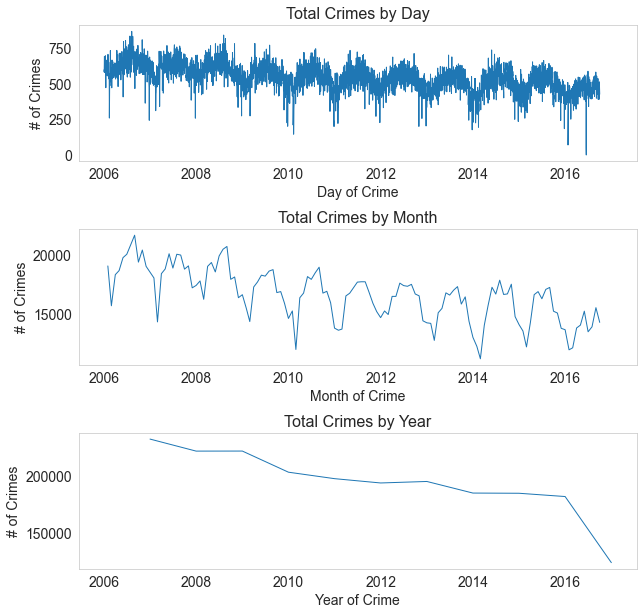

In [5]:
sns.set_style("whitegrid", {'axes.grid' : False})
fig = plt.figure(figsize=(10,10))
fig.subplots_adjust(hspace=.5)
ax1 = fig.add_subplot(3,1,1)
ax1.plot(acpc['crimes'].resample('D').count(),linewidth=1)
ax1.set_title('Total Crimes by Day', fontsize=16)
ax1.set_ylabel('# of Crimes', fontsize=14)
ax1.set_xlabel('Day of Crime', fontsize=14)
ax1.tick_params(axis='both', which='major', labelsize=14)

ax2 = fig.add_subplot(3,1,2, sharex=ax1)
ax2.plot(acpc['crimes'].resample('M').count(),linewidth=1)
ax2.set_title('Total Crimes by Month', fontsize=16)
ax2.set_ylabel('# of Crimes', fontsize=14)
ax2.set_xlabel('Month of Crime', fontsize=14)
ax2.tick_params(axis='both', which='major', labelsize=14)

ax3  = fig.add_subplot(3,1,3, sharex=ax1)
ax3.plot(acpc['crimes'].resample('A').count(),linewidth=1)
ax3.set_title('Total Crimes by Year', fontsize=16)
ax3.set_ylabel('# of Crimes', fontsize=14)
ax3.set_xlabel('Year of Crime', fontsize=14)
ax3.tick_params(axis='both', which='major', labelsize=14)

Text(0.5, 0, 'Year of Crime')

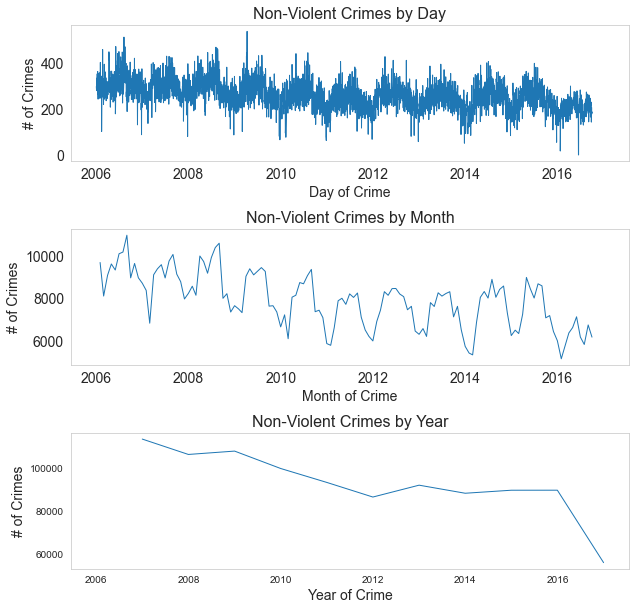

In [6]:
# non violent crimes by day, month, year
non_violent_df = acpc[acpc['UCR_General'] > 800]

fig = plt.figure(figsize=(10,10))
fig.subplots_adjust(hspace=.5)
ax1 = fig.add_subplot(3,1,1)
ax1.plot(non_violent_df['crimes'].resample('D').count(),linewidth=1)
ax1.set_title('Non-Violent Crimes by Day', fontsize=16)
ax1.set_ylabel('# of Crimes', fontsize=14)
ax1.set_xlabel('Day of Crime', fontsize=14)
ax1.tick_params(axis='both', which='major', labelsize=14)

ax2 = fig.add_subplot(3,1,2, sharex=ax1)
ax2.plot(non_violent_df['crimes'].resample('M').count(),linewidth=1)
ax2.set_title('Non-Violent Crimes by Month', fontsize=16)
ax2.set_ylabel('# of Crimes', fontsize=14)
ax2.set_xlabel('Month of Crime', fontsize=14)
ax2.tick_params(axis='both', which='major', labelsize=14)

ax3  = fig.add_subplot(3,1,3, sharex=ax1)
ax3.plot(non_violent_df['crimes'].resample('A').count(),linewidth=1)
ax3.set_title('Non-Violent Crimes by Year', fontsize=16)
ax3.set_ylabel('# of Crimes', fontsize=14)
ax3.set_xlabel('Year of Crime', fontsize=14)

Text(0.5, 0, 'Year of Crime')

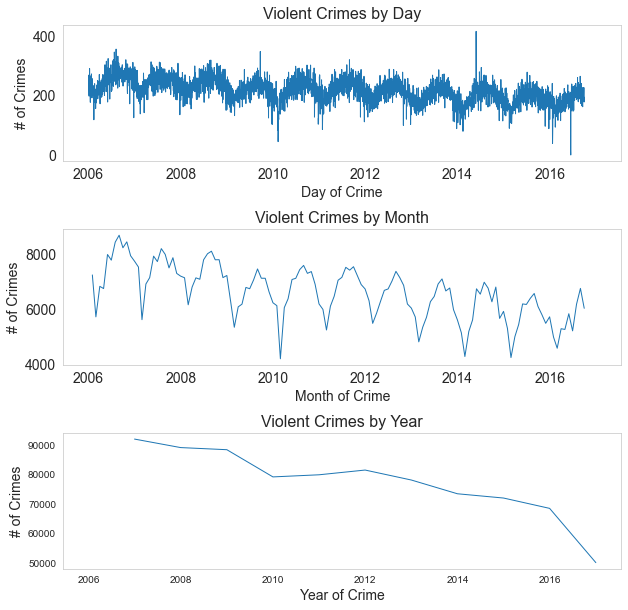

In [7]:
# violent crimes by day, month, year
violent_df = acpc[acpc['UCR_General'] < 800]

fig = plt.figure(figsize=(10,10))
fig.subplots_adjust(hspace=.5)
ax1 = fig.add_subplot(3,1,1)
ax1.plot(violent_df['crimes'].resample('D').count(),linewidth=1)
ax1.set_title('Violent Crimes by Day', fontsize=16)
ax1.set_ylabel('# of Crimes', fontsize=14)
ax1.set_xlabel('Day of Crime', fontsize=14)
ax1.tick_params(axis='both', which='major', labelsize=14)

ax2 = fig.add_subplot(3,1,2, sharex=ax1)
ax2.plot(violent_df['crimes'].resample('M').count(),linewidth=1)
ax2.set_title('Violent Crimes by Month', fontsize=16)
ax2.set_ylabel('# of Crimes', fontsize=14)
ax2.set_xlabel('Month of Crime', fontsize=14)
ax2.tick_params(axis='both', which='major', labelsize=14)

ax3  = fig.add_subplot(3,1,3, sharex=ax1)
ax3.plot(violent_df['crimes'].resample('A').count(),linewidth=1)
ax3.set_title('Violent Crimes by Year', fontsize=16)
ax3.set_ylabel('# of Crimes', fontsize=14)
ax3.set_xlabel('Year of Crime', fontsize=14)

Text(1.1, 547.1332823649337, 'overall average')

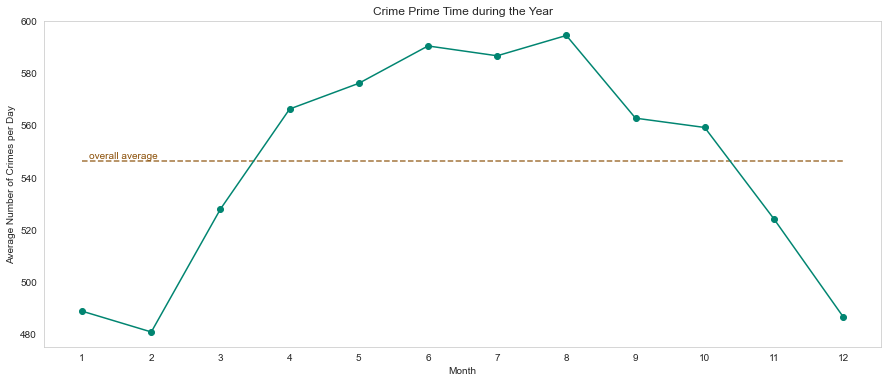

In [8]:
# total number of crimes for each month
crime_monthly = acpc.month.value_counts().sort_index()

# calculating the average number of crimes per day for the given month
month_total_days = acpc.groupby(["year", "month", "day"]).size().unstack("month").count()
crime_monthly_per_day = crime_monthly / month_total_days

# main plot
crime_monthly_per_day.plot(figsize=(15,6), marker="o", xticks=range(1, 13), title="Crime Prime Time during the Year", color="#018571") \
                     .set(xlabel="Month", ylabel="Average Number of Crimes per Day")

# plotting additional information
average_per_day = acpc.Dispatch_Date.value_counts().mean()    
plt.hlines(average_per_day, 1, 12, alpha=0.8, linestyle="--", color="#8c510a")
plt.text(1.1, average_per_day+1, "overall average", color="#8c510a")

In [9]:
# combining the different homicide types into one
def combining_homicide(crime):
    if pd.isnull(crime):
        return np.nan
    if "Homicide" in crime:
        return "Homicide - Criminal"
    else:
        return crime

acpc["Text_General_Code"] = acpc.Text_General_Code.apply(combining_homicide)

In [10]:
crime_types = pd.crosstab(acpc.Hour, acpc.Text_General_Code)

# dropping non-specific categories
crime_types = crime_types.drop(["All Other Offenses", "Other Assaults"], axis=1)

# using relative numbers to enable comparisons between the different types
# since some types are much more numerous than outhers
crime_types = crime_types.div(crime_types.sum())


#manually allocated the crime types into these groups
bio_rythm = [1,4,6,13,15,19,20,21,23]
nine_to_five = [7,8,9,16]
night_shift = [0,2,5,11,12,14,17,18,22]
other = [3,10]

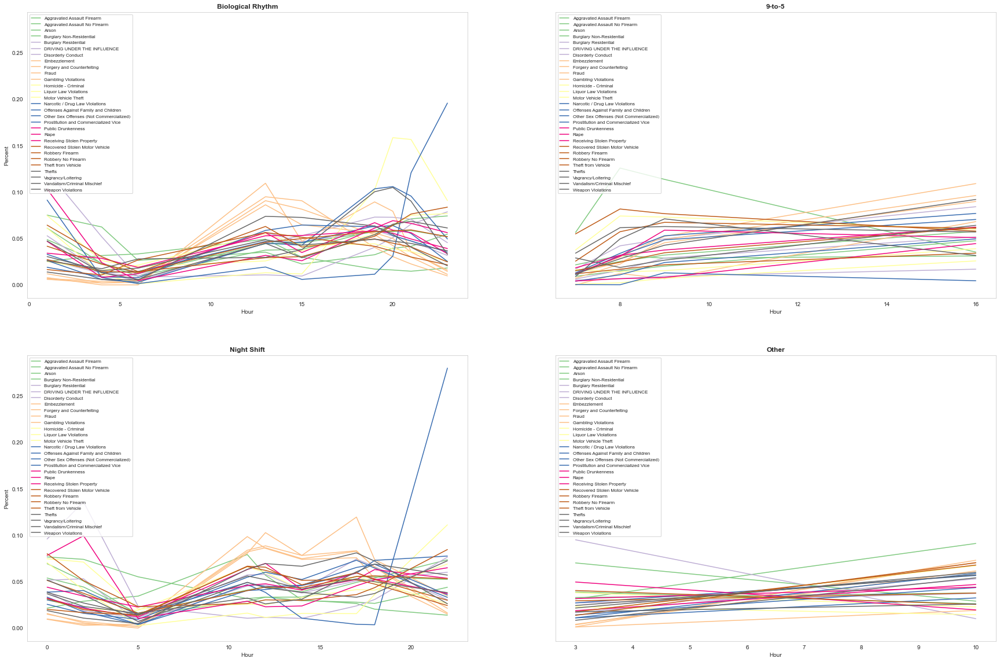

In [11]:
fig, ax = plt.subplots(2,2, figsize=(30,20), sharey=True)

plot_1 = crime_types.iloc[bio_rythm].plot(ax=ax[0][0], cmap="Accent") 
plot_1.set(ylabel="Percent", xlabel="Hour")
plot_1.set_title("Biological Rhythm", fontweight="bold")
plot_1.legend(loc=2, prop={'size': 8})

plot_2 = crime_types.iloc[nine_to_five].plot(ax=ax[0][1], cmap="Accent") 
plot_2.set(ylabel="Percent", xlabel="Hour")
plot_2.set_title("9-to-5", fontweight="bold")
plot_2.legend(loc=2, prop={'size': 8})

plot_3 = crime_types.iloc[night_shift].plot(ax=ax[1][0], cmap="Accent")
plot_3.set(ylabel="Percent", xlabel="Hour")
plot_3.set_title("Night Shift", fontweight="bold")
plot_3.legend(loc=2, prop={'size': 8})

plot_4 = crime_types.iloc[other].plot(ax=ax[1][1], cmap="Accent")
plot_4.set(ylabel="Percent", xlabel="Hour")
plot_4.set_title("Other", fontweight="bold")
plot_4.legend(loc=2, prop={'size': 8})

### Do criminals celebrate holidays?


In [12]:
# calculating the average number of crimes for the respective day of the year
years_of_data = 11
holidays = acpc.groupby(["month", "day"]).size() / years_of_data

# the 29th of February occured only 3-times during the period that the data set covers 
holidays[2][29] = (holidays[2][29] * years_of_data) / 3

In [13]:
# making sure that the xticks in the following graph are always on the first of the month
days_of_month_leap_year = [31,29,31,30,31,30,31,31,30,31,30,31]
ticks_leap_year = []

n = 0
for days in days_of_month_leap_year:
    ticks_leap_year.append(n)
    n += days

Text(295, 218, 'Christmas')

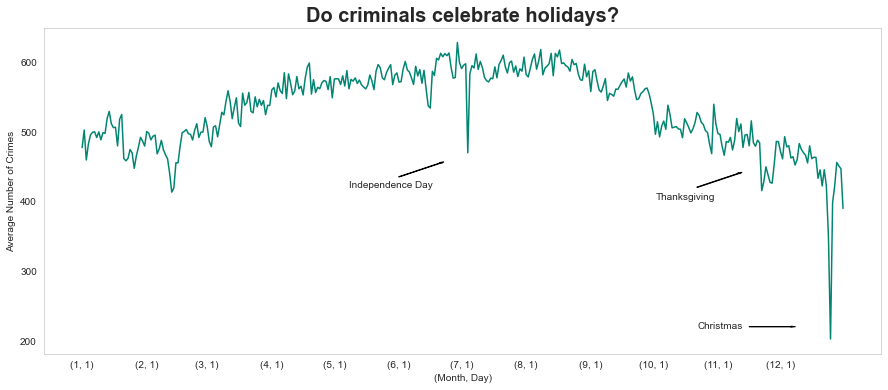

In [14]:
plot = holidays.plot(figsize=(15,6), xticks=ticks_leap_year, color="#018571")
plot.set(xlabel="(Month, Day)", ylabel="Average Number of Crimes")
plot.set_title("Do criminals celebrate holidays?", fontweight="bold", fontsize=20)
    
# Independence Day
plt.arrow(152,435,20,20, width=0.5, color="k", head_starts_at_zero=False)
plt.text(128,420, "Independence Day")

# Thanksgiving
plt.arrow(295,420,20,20, width=0.5, color="k", head_starts_at_zero=False)
plt.text(275,402, "Thanksgiving")

# Christmas
plt.arrow(320,220,20,0, width=0.5, color="k", head_starts_at_zero=False)
plt.text(295,218, "Christmas")

As one can see in the graph, there are clear drops at the 4th of July and Christmas. Thanksgiving, however, doesn't have a fix date but instead its date always changes between the 22nd and 28th of November. And as one can see, there is a visible dent in that period. So, criminals seem to celebrate holidays, too.

Side Note: There is also a drop in the middle of February but I don't know what holiday or event could have caused it or if it is just a coincidence.

In [15]:
# Violent crimes seem to have to most notible time series. 
# Let focus on this subset for now
monthly_violent_df = violent_df['crimes'].resample('M').count().to_frame()

### Seasonal Decompisition

**Trends - What is the overall trend in the data? <br>
Seasonality - How does crimes fluctuate between seasons?<br>
Residuals - When removing trends and seasonaility what does the data look like?<br>**

In [16]:
from statsmodels.tsa.seasonal import seasonal_decompose
decomposition = seasonal_decompose(monthly_violent_df)

trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

Text(0.5, 1.0, 'Residual')

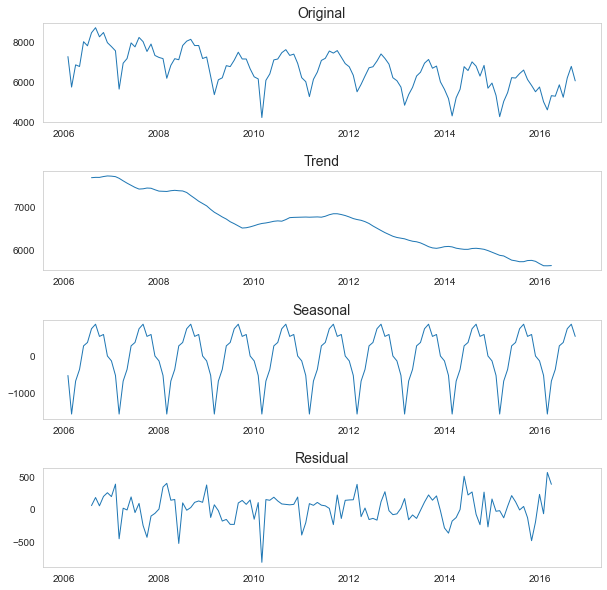

In [17]:


fig = plt.figure(figsize=(10,10))
fig.subplots_adjust(hspace=.5)
ax1 = fig.add_subplot(4,1,1)
ax1.plot(monthly_violent_df,linewidth=1)
ax1.set_title('Original', fontsize=14)

ax2 = fig.add_subplot(4,1,2, sharex=ax1)
ax2.plot(trend,linewidth=1)
ax2.set_title('Trend', fontsize=14)

ax3  = fig.add_subplot(4,1,3, sharex=ax1)
ax3.plot(seasonal,linewidth=1)
ax3.set_title('Seasonal', fontsize=14)

ax4  = fig.add_subplot(4,1,4, sharex=ax1)
ax4.plot(residual,linewidth=1)
ax4.set_title('Residual', fontsize=14)

**Trends - An almost linear decline in the number of monthly violent crimes <br>
Seasonality - It looks like there correlation with seasons with a peak in the summer months and a trough in the winter months <br>
Residuals - This mostly looks like noise, however we can improve on this <br>**

### Make the Data Stationary

1. The mean of the series should not be a function of time rather should be a constant. The image below has the left hand graph satisfying the condition whereas the graph in red has a time dependent mean.

2. The variance of the series should not a be a function of time. This property is known as homoscedasticity. Following graph depicts what is and what is not a stationary series. (Notice the varying spread of distribution in the right hand graph)

3. The covariance of the i th term and the (i + m) th term should not be a function of time. In the following graph, you will notice the spread becomes closer as the time increases. Hence, the covariance is not constant with time for the ‘red series’.

**Augmented Dickey-Fuller Test of Stationarity**<br>
We can use this statistical test to determine if the data is stationary<br>

**Null hypothesis** - a unit root is present in a time series sample<br>
**Alternative hypothesis** - the data is stationary<br>

In [18]:
from statsmodels.tsa.stattools import adfuller
def is_stationary(series):
    
    #Determing rolling statistics
    rolmean = series.rolling(window=12, center = False).mean()
    rolstd = series.rolling(window=12, center = False).std()

    #Plot rolling statistics:
    fig = plt.figure(figsize=(10,5))
    orig = plt.plot(series,label='Original')
    mean = plt.plot(rolmean, label= 'Rolling Mean')
    std = plt.plot(rolstd, label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey-Fuller test:
    print ('Results of Dickey-Fuller Test:')
    dftest = adfuller(series, autolag='AIC')
    dfoutput = pd.Series(dftest[0], index=['Test Statistic'])
    for key,crimes in dftest[4].items():
        dfoutput['Critical value (%s)'%key] = crimes
    print (dfoutput)

In [19]:
monthly_violent_df['log_crimes'] = np.log(monthly_violent_df.crimes)
monthly_violent_df['seasonal'] = seasonal
monthly_violent_df['seasonal_decomp'] = monthly_violent_df['crimes'] - monthly_violent_df['seasonal']
monthly_violent_df['seasonal_decomp_diff'] = monthly_violent_df.seasonal_decomp.diff(1)
monthly_violent_df['monthly_diff'] = monthly_violent_df.crimes.diff(1)
monthly_violent_df['seasonal_diff'] = monthly_violent_df.crimes.diff(12)
monthly_violent_df['seasonal_monthly_diff'] = monthly_violent_df.monthly_diff - monthly_violent_df.monthly_diff.diff(12)

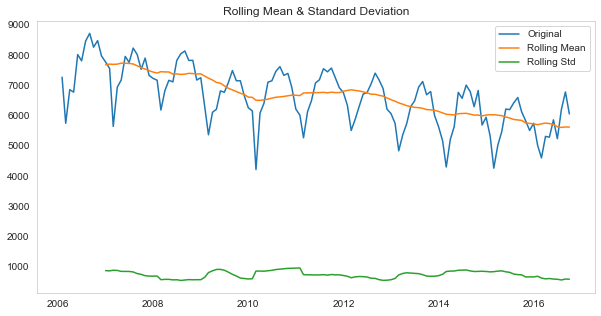

Results of Dickey-Fuller Test:
Test Statistic         -0.938033
Critical value (1%)    -3.488535
Critical value (5%)    -2.887020
Critical value (10%)   -2.580360
dtype: float64


In [20]:
# Original Data
is_stationary(monthly_violent_df.crimes)

Unsurprisingly the original data fails the augmeneted Dickey-Fuller Test (T-Statistic > Critical value 1% )

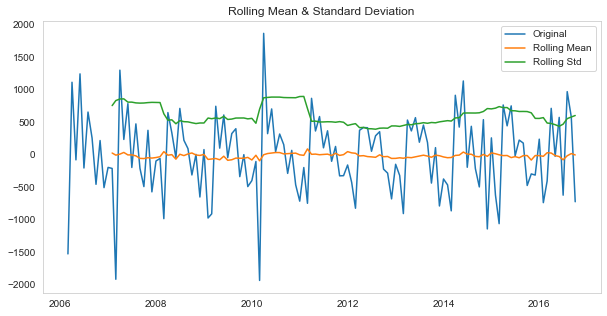

Results of Dickey-Fuller Test:
Test Statistic         -3.890816
Critical value (1%)    -3.488535
Critical value (5%)    -2.887020
Critical value (10%)   -2.580360
dtype: float64


In [21]:
# Trying with a difference in time of 1
is_stationary(monthly_violent_df.monthly_diff.dropna())

This looks much better! Our data is now below our 1% critical value. Let's see if we can further improve

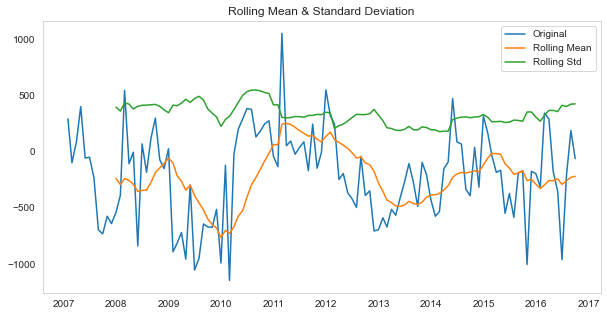

Results of Dickey-Fuller Test:
Test Statistic         -3.569863
Critical value (1%)    -3.494220
Critical value (5%)    -2.889485
Critical value (10%)   -2.581676
dtype: float64


In [22]:
#  account for seasonality by using a difference in time of 12
is_stationary(monthly_violent_df.seasonal_diff.dropna())

This looks good, but worse than just a monthly lag

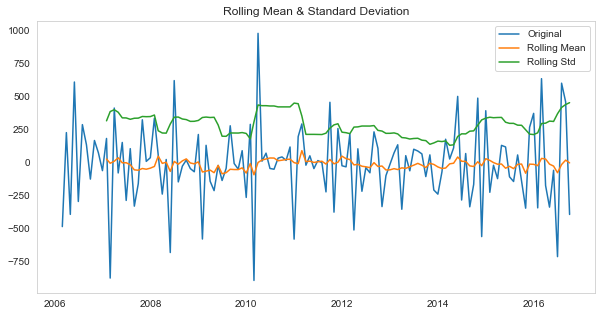

Results of Dickey-Fuller Test:
Test Statistic         -7.589421
Critical value (1%)    -3.484667
Critical value (5%)    -2.885340
Critical value (10%)   -2.579463
dtype: float64


In [24]:
is_stationary(monthly_violent_df.seasonal_decomp_diff.dropna())

### Getting Optimal Parameters for ARIMA

**Goal: Determine optimal number or AR terms (p), MA terms (q), and Differences (d)<br>
Plot Autocorrelation Function (ACF) and Partial Autocorrelation Functio (PACF)**

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1434: RuntimeWarning: invalid value encountered in sqrt
  return rho, np.sqrt(sigmasq)


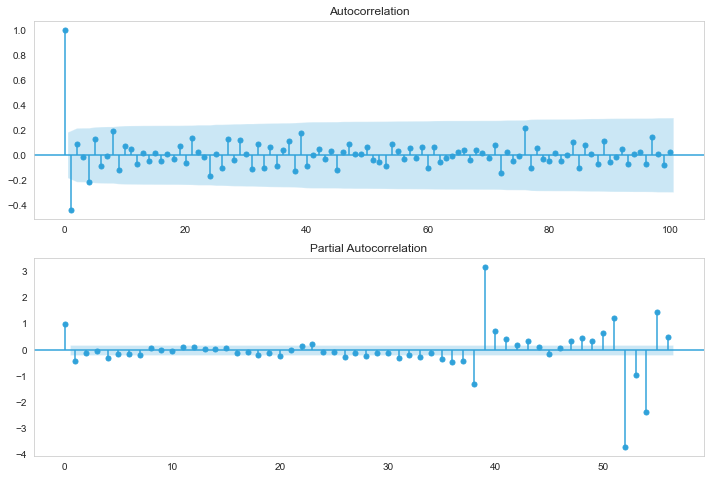

In [31]:
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(monthly_violent_df.seasonal_decomp_diff.dropna().iloc[13:], lags=100, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(monthly_violent_df.seasonal_decomp_diff.dropna().iloc[13:], lags=56, ax=ax2)

1. p – The lag value where the PACF chart crosses the upper confidence interval for the first time. p=1.
2. q – The lag value where the ACF chart crosses the upper confidence interval for the first time. q=1.

The ACF and PACF graphs look great and show that we did a nice job of making the data stationary. Let's use these results to fit our ARIMA model

### Fit an ARIMA Model
**Goal: Using the results from our ACF/PACF plots, fit an ARIMA model. Determine the optimal model by measuring Mean Absolue Percentage Error**

#### MA Model

                               ARMA Model Results                               
Dep. Variable:     seasonal_decomp_diff   No. Observations:                  128
Model:                       ARMA(0, 1)   Log Likelihood                -891.276
Method:                         css-mle   S.D. of innovations            255.229
Date:                  Sat, 04 Jun 2022   AIC                           1788.553
Time:                          22:04:46   BIC                           1797.109
Sample:                      02-28-2006   HQIC                          1792.029
                           - 09-30-2016                                         
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                        -15.9407      8.401     -1.898      0.058     -32.406       0.524
ma.L1.seasonal_decomp_diff    -0.6327      0.087     -7.293      0.

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\tsa\arima_model.py:472: FutureWarning: 
statsmodels.tsa.arima_model.ARMA and statsmodels.tsa.arima_model.ARIMA have
been deprecated in favor of statsmodels.tsa.arima.model.ARIMA (note the .
between arima and model) and
statsmodels.tsa.SARIMAX. These will be removed after the 0.12 release.

statsmodels.tsa.arima.model.ARIMA makes use of the statespace framework and
is both well tested and maintained.

To silence this warning and continue using ARMA and ARIMA until they are
removed, use:

import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

  warnings.warn(ARIMA_DEPRECATION_WARN, FutureWarning)


Text(0.5, 0, 'Year of Crime')

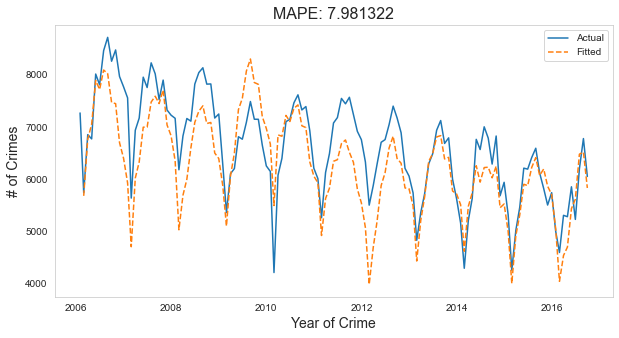

In [28]:
model = ARIMA(monthly_violent_df.seasonal_decomp_diff.dropna(),order=(0,0,1))
results = model.fit()

print (results.summary())

monthly_violent_df['forecast'] = pd.Series(monthly_violent_df.crimes.iloc[0], index = monthly_violent_df.index) \
                                .add(results.fittedvalues.cumsum()).add(monthly_violent_df.seasonal)
fig = plt.figure(figsize=(10,5))
plt.plot(monthly_violent_df.crimes, label = 'Actual')
plt.plot(monthly_violent_df.forecast,linestyle="--", label='Fitted')
plt.legend(loc='best')
plt.title('MAPE: %f' % (100*np.mean(np.abs(monthly_violent_df.forecast-monthly_violent_df.crimes)/monthly_violent_df.crimes)), fontsize=16)
plt.ylabel('# of Crimes', fontsize=14)
plt.xlabel('Year of Crime', fontsize=14)

#### AR Model

                               ARMA Model Results                               
Dep. Variable:     seasonal_decomp_diff   No. Observations:                  128
Model:                       ARMA(1, 1)   Log Likelihood                -890.908
Method:                         css-mle   S.D. of innovations            254.400
Date:                  Sat, 04 Jun 2022   AIC                           1789.817
Time:                          22:04:38   BIC                           1801.225
Sample:                      02-28-2006   HQIC                          1794.452
                           - 09-30-2016                                         
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                        -16.3343      6.795     -2.404      0.016     -29.652      -3.017
ar.L1.seasonal_decomp_diff     0.1540      0.167      0.924      0.

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\tsa\arima_model.py:472: FutureWarning: 
statsmodels.tsa.arima_model.ARMA and statsmodels.tsa.arima_model.ARIMA have
been deprecated in favor of statsmodels.tsa.arima.model.ARIMA (note the .
between arima and model) and
statsmodels.tsa.SARIMAX. These will be removed after the 0.12 release.

statsmodels.tsa.arima.model.ARIMA makes use of the statespace framework and
is both well tested and maintained.

To silence this warning and continue using ARMA and ARIMA until they are
removed, use:

import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

  warnings.warn(ARIMA_DEPRECATION_WARN, FutureWarning)


Text(0.5, 0, 'Year of Crime')

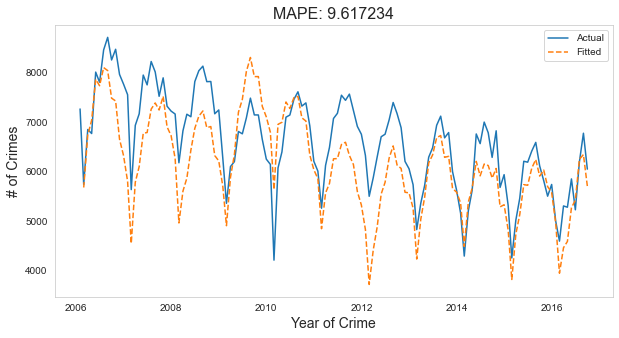

In [27]:
model = ARIMA(monthly_violent_df.seasonal_decomp_diff.dropna(),order=(1,0,1))

results = model.fit(dips=-1)

print (results.summary())

monthly_violent_df['forecast'] = pd.Series(monthly_violent_df.crimes.iloc[0], index = monthly_violent_df.index) \
                                .add(results.fittedvalues.cumsum()).add(monthly_violent_df.seasonal)
    
fig = plt.figure(figsize=(10,5))
plt.plot(monthly_violent_df.crimes, label = 'Actual')
plt.plot(monthly_violent_df.forecast,linestyle="--", label='Fitted')
plt.legend(loc='best')
plt.title('MAPE: %f' % (100*np.mean(np.abs(monthly_violent_df.forecast-monthly_violent_df.crimes)/monthly_violent_df.crimes)), fontsize=16)
plt.ylabel('# of Crimes', fontsize=14)
plt.xlabel('Year of Crime', fontsize=14)

#### Combined Model AR & MA

                               ARMA Model Results                               
Dep. Variable:     seasonal_decomp_diff   No. Observations:                  128
Model:                       ARMA(1, 1)   Log Likelihood                -890.908
Method:                         css-mle   S.D. of innovations            254.400
Date:                  Sat, 04 Jun 2022   AIC                           1789.817
Time:                          22:04:26   BIC                           1801.225
Sample:                      02-28-2006   HQIC                          1794.452
                           - 09-30-2016                                         
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                        -16.3343      6.795     -2.404      0.016     -29.652      -3.017
ar.L1.seasonal_decomp_diff     0.1540      0.167      0.924      0.

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\tsa\arima_model.py:472: FutureWarning: 
statsmodels.tsa.arima_model.ARMA and statsmodels.tsa.arima_model.ARIMA have
been deprecated in favor of statsmodels.tsa.arima.model.ARIMA (note the .
between arima and model) and
statsmodels.tsa.SARIMAX. These will be removed after the 0.12 release.

statsmodels.tsa.arima.model.ARIMA makes use of the statespace framework and
is both well tested and maintained.

To silence this warning and continue using ARMA and ARIMA until they are
removed, use:

import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

  warnings.warn(ARIMA_DEPRECATION_WARN, FutureWarning)


Text(0.5, 0, 'Year of Crime')

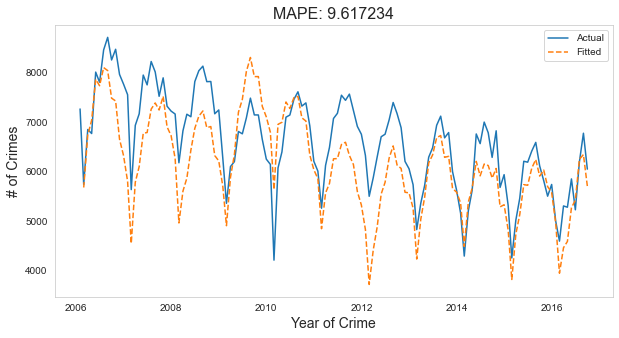

In [26]:
model = ARIMA(monthly_violent_df.seasonal_decomp_diff.dropna(),order=(1,0,1))

results = model.fit(dips=-1)

print (results.summary())

monthly_violent_df['forecast'] = pd.Series(monthly_violent_df.crimes.iloc[0], index = monthly_violent_df.index) \
                                .add(results.fittedvalues.cumsum()).add(monthly_violent_df.seasonal)
    
fig = plt.figure(figsize=(10,5))
plt.plot(monthly_violent_df.crimes, label = 'Actual')
plt.plot(monthly_violent_df.forecast,linestyle="--", label='Fitted')
plt.legend(loc='best')
plt.title('MAPE: %f' % (100*np.mean(np.abs(monthly_violent_df.forecast-monthly_violent_df.crimes)/monthly_violent_df.crimes)), fontsize=16)
plt.ylabel('# of Crimes', fontsize=14)
plt.xlabel('Year of Crime', fontsize=14)

### Violent / non-violent Crimes Classification

In [3]:
df = acp.drop(columns=['Dispatch_Date', 'Dispatch_Date_Time','Dispatch_Time','Hour','Location_Block','Month'])
df = df.iloc[:int(df.shape[0]/2)]

In [4]:
df.head()

,Dc_Dist,Psa,Dc_Key,UCR_General,Text_General_Code,Police_Districts,Lon,Lat
0,18,3,200918067518,800.0,Other Assaults,NaN,NaN,NaN
1,14,1,200914033994,2600.0,All Other Offenses,NaN,NaN,NaN
2,25,J,200925083199,800.0,Other Assaults,NaN,NaN,NaN
3,35,D,200935061008,1500.0,Weapon Violations,20.0,-75.130477,40.036389
4,9,R,200909030511,2600.0,All Other Offenses,8.0,-75.166350,39.969532


In [5]:
labelencoder = LabelEncoder()

df['Psa'] = labelencoder.fit_transform(df['Psa'])
df['Text_General_Code'] =labelencoder.fit_transform(df['Text_General_Code'])

In [6]:
df.dtypes

Dc_Dist                int64
Psa                    int32
Dc_Key                 int64
UCR_General          float64
Text_General_Code      int32
Police_Districts     float64
Lon                  float64
Lat                  float64
dtype: object

In [7]:
df.isnull().sum()

Dc_Dist                 0
Psa                     0
Dc_Key                  0
UCR_General             0
Text_General_Code       0
Police_Districts     8899
Lon                  7568
Lat                  7568
dtype: int64

In [8]:
df = df.dropna()

In [9]:
df.isnull().sum()

Dc_Dist              0
Psa                  0
Dc_Key               0
UCR_General          0
Text_General_Code    0
Police_Districts     0
Lon                  0
Lat                  0
dtype: int64

In [10]:
for i in range (0, len(df['UCR_General'])):
    if df['UCR_General'].values[i] <= 800: #violent crimes class (1)
        df['UCR_General'].values[i] = 1
    elif df['UCR_General'].values[i] > 800: #non-violent crimes class (0)
        df['UCR_General'].values[i] = 0
        

In [11]:
df['UCR_General']=df['UCR_General'].astype('int')

In [12]:
df.head()

,Dc_Dist,Psa,Dc_Key,UCR_General,Text_General_Code,Police_Districts,Lon,Lat
3,35,7,200935061008,0,31,20.0,-75.130477,40.036389
4,9,21,200909030511,0,2,8.0,-75.166350,39.969532
5,17,0,201517017705,1,28,13.0,-75.166412,39.940070
6,23,14,200923006310,1,18,16.0,-75.171149,39.979586
12,22,2,201522089374,1,28,16.0,-75.160229,39.976134


In [13]:
df.UCR_General.value_counts()

1    573140
0    536763
Name: UCR_General, dtype: int64

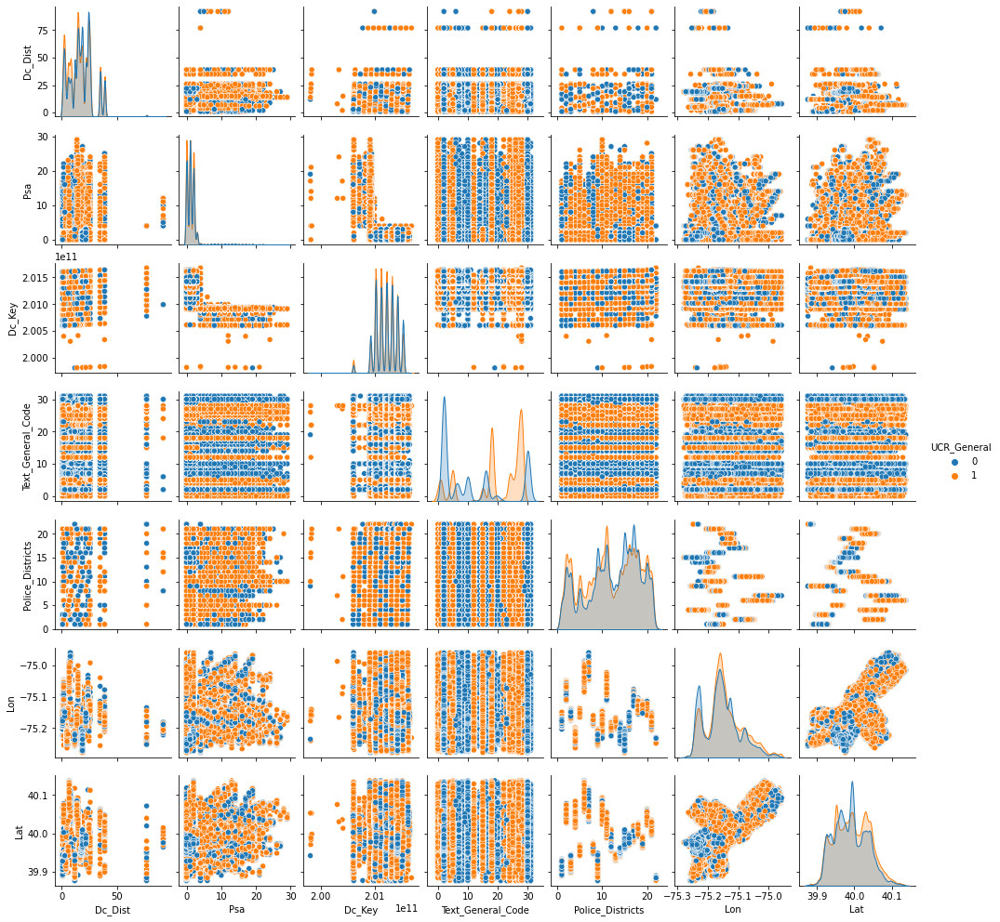

In [14]:
sns.pairplot(df,hue = 'UCR_General', height=2)

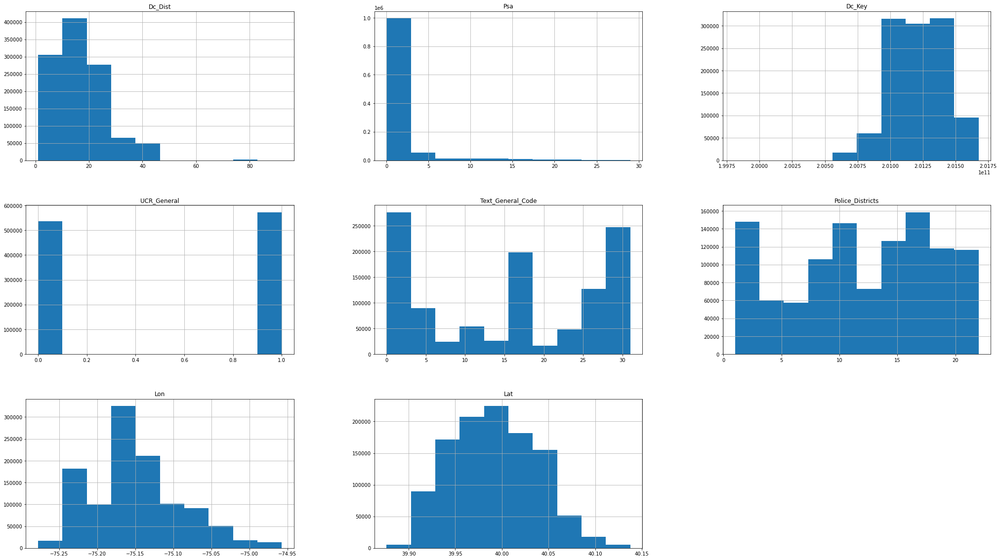

In [33]:
df.hist(figsize=(35, 20))
plt.show()

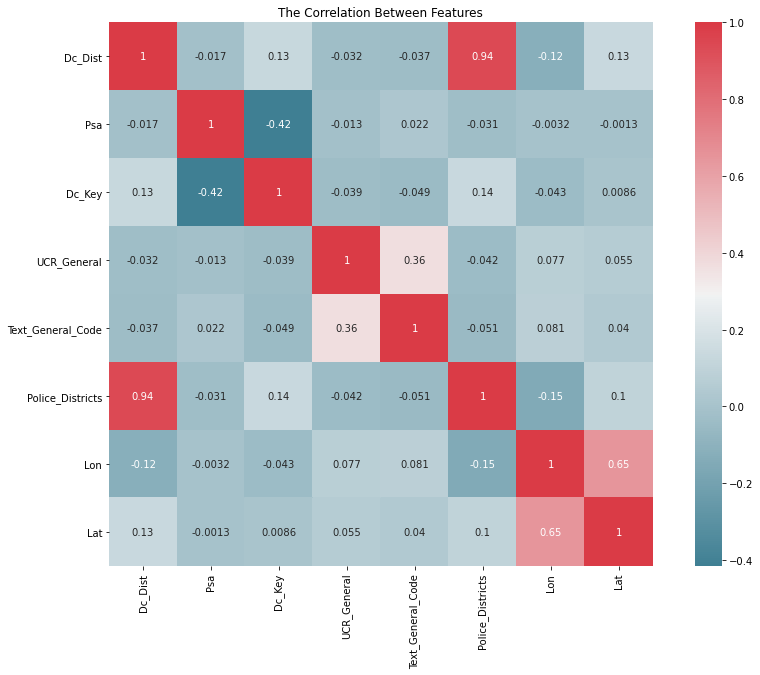

In [15]:
f, ax = plt.subplots(figsize=(15, 10))
corr = df.corr()
sns.heatmap(corr,mask=np.zeros_like(corr, dtype=np.bool), cmap=sns.diverging_palette(220, 10, as_cmap=True),
            square=True, ax=ax, annot = True)
plt.title('The Correlation Between Features')
plt.show()

In [16]:
X = df.iloc[:, :-1]
Y = df['UCR_General']

In [17]:
def prepare_df(df, verbose=True, scale=True):
    # getting the features and targets
    x = df.iloc[:, :-1]
    y = df['UCR_General']
    
    # using stratify to handle unbalanced classes while splitting the data
    x_train, x_valid, y_train, y_valid = train_test_split(x, y, test_size=0.3, stratify=y, random_state=42)
    
    if verbose:
        print('----- Data Splits Summary -----')
        print(f'train size: {x_train.shape[0]} | valid size: {x_valid.shape[0]}')

        # percentage of each class in train and valid
        print('\nPercentage of classes in the train dataset:')
        target_classes = [0., 1.]
        for i in target_classes:
            print(f'Class {i}: {(y_train==i).sum()/y_train.shape[0]:.3f}')

        print('\nPercentage of classes in the valid dataset:')
        for i in target_classes:
            print(f'Class {i}: {(y_valid==i).sum()/y_valid.shape[0]:.3f}')
            
        
    # Scaling the data
    if scale:
        scaler = StandardScaler()

        x_train = scaler.fit_transform(x_train)
        x_valid = scaler.transform(x_valid)
        
    return x_train, y_train, x_valid, y_valid

In [18]:
x_train, y_train, x_valid, y_valid = prepare_df(df)

----- Data Splits Summary -----
train size: 776932 | valid size: 332971

Percentage of classes in the train dataset:
Class 0.0: 0.484
Class 1.0: 0.516

Percentage of classes in the valid dataset:
Class 0.0: 0.484
Class 1.0: 0.516


In [19]:
def fit_model(model, x_train, y_train, x_valid, y_valid, return_scores=False):
    # fitting the model
    model.fit(x_train, y_train)
    
    # Scores
    train_score = model.score(x_train, y_train)
    y_pred = model.predict(x_valid)
    valid_score = accuracy_score(y_pred, y_valid)
    conf_mx = confusion_matrix(y_valid, y_pred)
    precision = precision_score(y_valid, y_pred, average='weighted')
    recall = recall_score(y_valid, y_pred, average='weighted')
    f1 = f1_score(y_valid, y_pred, average='weighted')
    balanced = balanced_accuracy_score(y_valid, y_pred)

    if return_scores:
        return train_score, valid_score, balanced, precision, recall, f1
    
    print('----- Model Scores -----')
    print(f"train score: {train_score:.4f} | valid score: {valid_score:.4f}")
    print(f"precision  : {precision:.4f} | recall     : {recall:.4f}")
    print(f"f1 score   : {f1:.4f} | balanced   : {balanced:.4f}")
    plot_confusion_matrix(model, x_valid, y_valid, display_labels=['0', '1'],
                         values_format='')

    return model

### KNN

----- Model Scores -----
train score: 1.0000 | valid score: 1.0000
precision  : 1.0000 | recall     : 1.0000
f1 score   : 1.0000 | balanced   : 1.0000


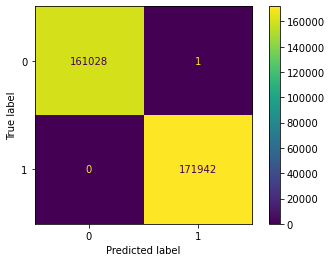

In [29]:
# KNN test run to determine the optimal n_neighbors
knn = KNeighborsClassifier()
knn = fit_model(knn, x_train, y_train, x_valid, y_valid)

In [30]:
train_pcts = np.arange(.1, 1.1, .1)

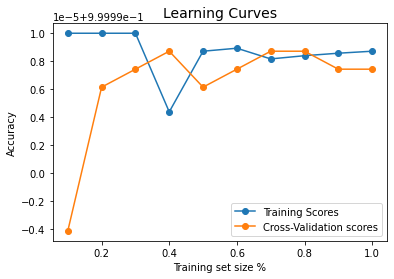

In [31]:
_, train_scores_knn, valid_scores_knn, *_ = learning_curve(knn, x_train, y_train, train_sizes=train_pcts)

plt.plot(train_pcts, train_scores_knn.mean(axis=1), 'o-')
plt.plot(train_pcts, valid_scores_knn.mean(axis=1), 'o-')
plt.title('Learning Curves', fontsize=14)
plt.legend(['Training Scores', 'Cross-Validation scores'])
plt.xlabel('Training set size %')
plt.ylabel('Accuracy')
plt.show()

### Random Forest

----- Model Scores -----
train score: 1.0000 | valid score: 1.0000
precision  : 1.0000 | recall     : 1.0000
f1 score   : 1.0000 | balanced   : 1.0000


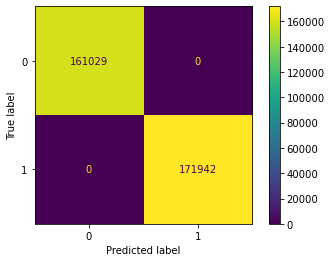

In [20]:
rf = RandomForestClassifier(random_state=42)
rf = fit_model(rf, x_train, y_train, x_valid, y_valid)

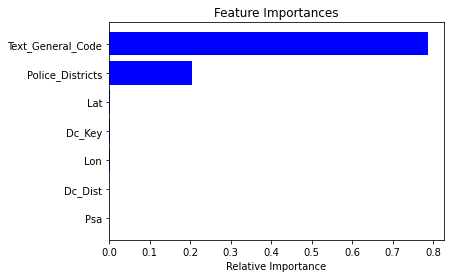

In [21]:
importances = rf.feature_importances_
indices = np.argsort(importances)

features = ['Dc_Dist', 'Psa', 'Dc_Key', 'Text_General_Code', 'Police_Districts', 'Lon', 'Lat']


plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

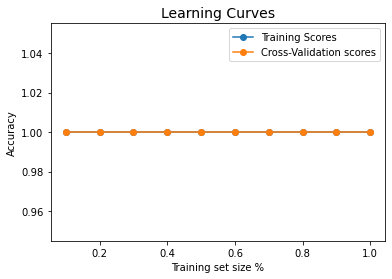

In [24]:
_, train_scores_rf, valid_scores_rf, *_ = learning_curve(rf, x_train, y_train, train_sizes=train_pcts)

plt.plot(train_pcts, train_scores_rf.mean(axis=1), 'o-')
plt.plot(train_pcts, valid_scores_rf.mean(axis=1), 'o-')
plt.title('Learning Curves', fontsize=14)
plt.legend(['Training Scores', 'Cross-Validation scores'])
plt.xlabel('Training set size %')
plt.ylabel('Accuracy')
plt.show()

### SVM

----- Model Scores -----
train score: 1.0000 | valid score: 1.0000
precision  : 1.0000 | recall     : 1.0000
f1 score   : 1.0000 | balanced   : 1.0000


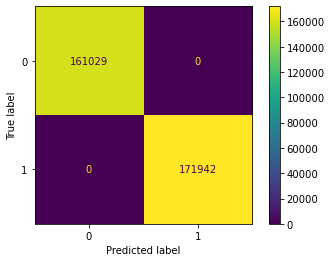

In [25]:
# The default model
svc = SVC()
svc = fit_model(svc, x_train, y_train, x_valid, y_valid)

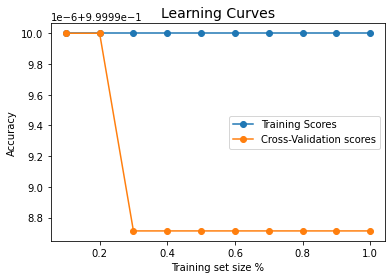

In [26]:
_, train_scores_svc, valid_scores_svc, *_ = learning_curve(svc, x_train, y_train, train_sizes=train_pcts)

plt.plot(train_pcts, train_scores_svc.mean(axis=1), 'o-')
plt.plot(train_pcts, valid_scores_svc.mean(axis=1), 'o-')
plt.title('Learning Curves', fontsize=14)
plt.legend(['Training Scores', 'Cross-Validation scores'])
plt.xlabel('Training set size %')
plt.ylabel('Accuracy')
plt.show()

### Performance Comparison

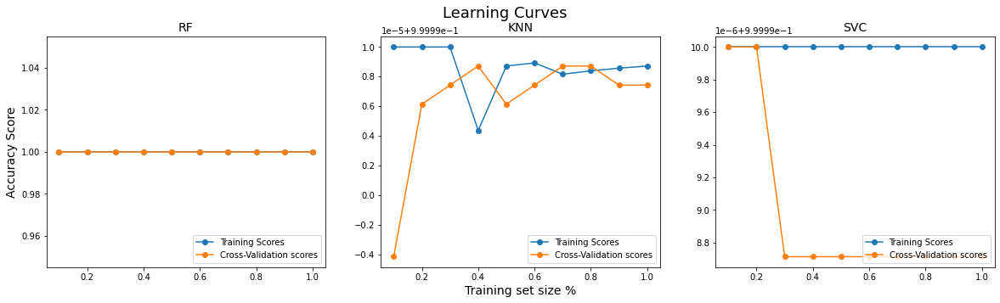

In [32]:
fig, axes = plt.subplots(1, 3, figsize=(20, 5))
fig.suptitle('Learning Curves', fontsize=18)

# RF
axes[0].plot(train_pcts, train_scores_rf.mean(axis=1), 'o-')
axes[0].plot(train_pcts, valid_scores_rf.mean(axis=1), 'o-')
axes[0].legend(['Training Scores', 'Cross-Validation scores'], loc='lower right')
axes[0].set_title('RF', fontsize=14)
axes[0].set_ylabel('Accuracy Score', fontsize=14)

#KNN
axes[1].plot(train_pcts, train_scores_knn.mean(axis=1), 'o-')
axes[1].plot(train_pcts, valid_scores_knn.mean(axis=1), 'o-')
axes[1].legend(['Training Scores', 'Cross-Validation scores'], loc='lower right')
axes[1].set_title('KNN', fontsize=14)
axes[1].set_xlabel('Training set size %', fontsize=14)

# SVR
axes[2].plot(train_pcts, train_scores_svc.mean(axis=1), 'o-')
axes[2].plot(train_pcts, valid_scores_svc.mean(axis=1), 'o-')
axes[2].legend(['Training Scores', 'Cross-Validation scores'], loc='lower right')
axes[2].set_title('SVC', fontsize=14)
plt.show()

#### Comparing Accuracy

In [33]:
# Best scores from the models
# RF
rf = RandomForestClassifier(n_estimators=69, max_features='sqrt', random_state=42)
rf_train, rf_valid, rf_balanced, rf_precision, rf_recall, rf_f1 = fit_model(rf, x_train, y_train, x_valid, y_valid, return_scores=True)

# KNN
knn = KNeighborsClassifier(n_neighbors=1)
knn_train, knn_valid, knn_balanced, knn_precision, knn_recall, knn_f1 = fit_model(knn, x_train, y_train, x_valid, y_valid, return_scores=True)

# SVC
svc = SVC(kernel='linear')
svc_train, svc_valid, svc_balanced, svc_precision, svc_recall, svc_f1 = fit_model(svc, x_train, y_train, x_valid, y_valid, return_scores=True)

In [34]:
models_performance = pd.DataFrame({
    'Model': ['RF', 'KNN', 'SVC'],
    'Train Accuracy': [rf_train, knn_train, svc_train],
    'Valid Accuracy': [rf_valid, knn_valid, svc_valid],
    'Balanced': [rf_balanced, knn_balanced, svc_balanced],
    'Precision': [rf_precision, knn_precision, svc_precision],
    'Recall': [rf_recall, knn_recall, svc_recall], 
    'F1': [rf_f1, knn_f1, svc_f1]
})

models_performance

,Model,Train Accuracy,Valid Accuracy,Balanced,Precision,Recall,F1
0,RF,1.0,1.0,1.0,1.0,1.0,1.0
1,KNN,1.0,1.0,1.0,1.0,1.0,1.0
2,SVC,1.0,1.0,1.0,1.0,1.0,1.0


### MLP

In [35]:
# Separate features and targets
X = df.iloc[:, :-1]
Y = df['UCR_General']

# Standardizing the dataset
sc= StandardScaler()
X = sc.fit_transform(X)

# Set the input shape
input_shape = (7,)
print(f'Feature shape: {input_shape}')

# Create the model
model = Sequential()
model.add(Dense(1000, input_shape=(7,), activation='relu'))
model.add(Dense(500, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


# Configure the model and start training
model.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])
model.fit(X, Y, epochs=4, batch_size=500, verbose=1, validation_split=0.2)

Feature shape: (7,)
Epoch 1/4
1776/1776 [==============================] - 19s 11ms/step - loss: 0.0015 - accuracy: 0.9997 - val_loss: 1.6566e-06 - val_accuracy: 1.0000
Epoch 2/4
1776/1776 [==============================] - 19s 11ms/step - loss: 5.6987e-07 - accuracy: 1.0000 - val_loss: 3.3486e-07 - val_accuracy: 1.0000
Epoch 3/4
1776/1776 [==============================] - 19s 11ms/step - loss: 1.4341e-07 - accuracy: 1.0000 - val_loss: 1.0419e-07 - val_accuracy: 1.0000
Epoch 4/4
1776/1776 [==============================] - 19s 11ms/step - loss: 4.9986e-08 - accuracy: 1.0000 - val_loss: 4.1952e-08 - val_accuracy: 1.0000


Neural Network Accuracy is 1.0000
Neural Network Loss is 0.0000
True Postive  : 161029	False Postive  : 0
False Negative  : 0	True Negative  : 171942


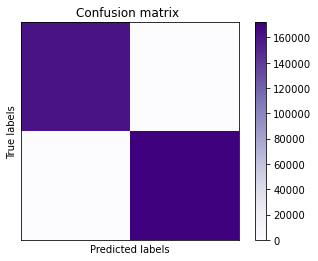

In [54]:
evaluation=model.evaluate(x_valid, y_valid,verbose=0)
print('Neural Network Accuracy is {:.4f}\nNeural Network Loss is {:.4f}'.format(evaluation[1],evaluation[0]))
y_pred=model.predict(x_valid)
y_pred=(y_pred>0.5)
cm=confusion_matrix(y_valid, y_pred)
print('True Postive  : '+str(cm[0][0])+'\tFalse Postive  : '+str(cm[0][1]))
print('False Negative  : '+str(cm[1][0])+'\tTrue Negative  : '+str(cm[1][1]))
plt.imshow(cm, cmap=plt.cm.Purples,)
plt.xlabel("Predicted labels")
plt.ylabel("True labels")
plt.xticks([], [])
plt.yticks([], [])
plt.title('Confusion matrix ')
plt.colorbar()
plt.show()